In [1]:
import glob

import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import matplotlib
%matplotlib inline

from pylab import rcParams

from utils import METRICS, CONT_PARAMETERS, LOG_PARAMETERS, SET_PARAMETERS, INT_PARAMETERS, read_files,\
    top_mean_dev_auc, top_min_whole_validation_auc, top_min_dev_auc, read_files

In [2]:
rcParams['figure.figsize'] = 20, 5
pd.set_option('display.max_columns', None)

In [3]:
%load_ext autoreload
%autoreload 2

In [4]:
files = ['./experiments/wide-20shuffle-3seed.pkl']

In [5]:
top_k = 100000
min_iterations = 50

In [6]:
best_mean_dev = top_mean_dev_auc(read_files(files), top_k)\
    .pipe(lambda x: x[x.groupby(['file', 'experiment_id']).iteration.transform('size') > min_iterations])
best_mean_dev.groupby(['file', 'experiment_id']).ngroups

219

In [7]:
best_min_dev = top_min_dev_auc(read_files(files), top_k)\
    .pipe(lambda x: x[x.groupby(['file', 'experiment_id']).iteration.transform('size') > min_iterations])
best_min_dev.groupby(['file', 'experiment_id']).ngroups

219

In [8]:
true_best = top_min_whole_validation_auc(read_files(files), top_k)\
    .pipe(lambda x: x[x.groupby(['file', 'experiment_id']).iteration.transform('size') > min_iterations])
true_best.groupby(['file', 'experiment_id']).ngroups

227

In [9]:
compare_columns = ['mean_dev_auc', 'mean_validation_auc',
               'mean_whole_validation_auc', 'min_dev_auc', 'min_validation_auc', 'min_whole_validation_auc']

In [10]:
best_mean_dev[compare_columns].describe().T

,count,mean,std,min,25%,50%,75%,max
mean_dev_auc,99838.0,0.809341,0.011158,0.792811,0.801012,0.806938,0.817224,0.836222
mean_validation_auc,99838.0,0.787952,0.011221,0.757318,0.779928,0.787453,0.796311,0.811560
mean_whole_validation_auc,99838.0,0.789810,0.011579,0.742193,0.782495,0.790065,0.798340,0.812687
min_dev_auc,99838.0,0.781251,0.019293,0.568651,0.772097,0.781932,0.793847,0.813151
min_validation_auc,99838.0,0.779035,0.018056,0.584426,0.768750,0.781354,0.789893,0.807616
min_whole_validation_auc,99838.0,0.787342,0.013893,0.701223,0.780249,0.788248,0.796919,0.812425


In [11]:
best_mean_dev.min_whole_validation_auc.corr(best_mean_dev.mean_dev_auc, method='spearman')

0.8634944295483993

In [12]:
best_mean_dev.mean_whole_validation_auc.corr(best_mean_dev.mean_dev_auc, method='spearman')

0.8790337579838666

In [13]:
best_min_dev[compare_columns].describe().T

,count,mean,std,min,25%,50%,75%,max
mean_dev_auc,99887.0,0.808278,0.012310,0.779945,0.799363,0.806870,0.817080,0.836222
mean_validation_auc,99887.0,0.786807,0.012518,0.749723,0.777986,0.787254,0.796034,0.811560
mean_whole_validation_auc,99887.0,0.789201,0.012499,0.723018,0.782111,0.790098,0.798402,0.812687
min_dev_auc,99887.0,0.783602,0.013886,0.759811,0.772194,0.781926,0.793842,0.813151
min_validation_auc,99887.0,0.780184,0.014057,0.731578,0.768357,0.781345,0.789884,0.807616
min_whole_validation_auc,99887.0,0.787197,0.013691,0.674365,0.779513,0.788357,0.797098,0.812425


In [14]:
best_min_dev.min_whole_validation_auc.corr(best_min_dev.min_dev_auc, method='spearman')

0.7799922298904304

In [15]:
best_min_dev.min_whole_validation_auc.corr(best_min_dev.mean_dev_auc, method='spearman')

0.8403468807575071

In [16]:
true_best[compare_columns].describe().T

,count,mean,std,min,25%,50%,75%,max
mean_dev_auc,99808.0,0.793029,0.061251,0.500000,0.798269,0.806846,0.817218,0.836222
mean_validation_auc,99808.0,0.773114,0.057391,0.500000,0.778754,0.787388,0.796310,0.811560
mean_whole_validation_auc,99808.0,0.793664,0.008661,0.777883,0.786790,0.792102,0.800443,0.812687
min_dev_auc,99808.0,0.757620,0.078200,0.338554,0.764058,0.781795,0.793842,0.813151
min_validation_auc,99808.0,0.756596,0.077187,0.357103,0.766385,0.781214,0.789893,0.807616
min_whole_validation_auc,99808.0,0.792137,0.008888,0.777773,0.784098,0.790598,0.798901,0.812425


In [17]:
true_best.min_whole_validation_auc.corr(true_best.min_dev_auc, method='spearman')

0.4961408359367977

In [18]:
true_best.min_whole_validation_auc.corr(true_best.mean_dev_auc, method='spearman')

0.5387561039297352

In [19]:
true_best.mean_whole_validation_auc.corr(true_best.min_dev_auc, method='spearman')

0.48262282247348015

In [20]:
true_best.mean_whole_validation_auc.corr(true_best.mean_dev_auc, method='spearman')

0.5464696905197118

In [21]:
best_mean_dev.merge(true_best, on=['file', 'experiment_id', 'iteration'])\
    .groupby(['file', 'experiment_id']).ngroups

181

In [22]:
best_mean_dev.merge(true_best, on=['file', 'experiment_id', 'iteration']).shape

(79329, 119)

In [23]:
best_min_dev.merge(true_best, on=['file', 'experiment_id', 'iteration'])\
    .groupby(['file', 'experiment_id']).ngroups

180

In [24]:
best_min_dev.merge(true_best, on=['file', 'experiment_id', 'iteration']).shape

(77901, 119)

In [25]:
best = best_mean_dev

In [26]:
best.shape

(99838, 61)

In [27]:
best.groupby(SET_PARAMETERS).min_whole_validation_auc.describe()

count      mean       std  \
param_is_unbalance param_boost_from_average                                
False              False                     14093.0  0.789212  0.010614   
                   True                      16145.0  0.788761  0.009844   
True               False                     47682.0  0.786002  0.014149   
                   True                      21918.0  0.788011  0.017083   

                                                  min       25%       50%  \
param_is_unbalance param_boost_from_average                                 
False              False                     0.727597  0.781889  0.788901   
                   True                      0.760959  0.781803  0.788078   
True               False                     0.701223  0.777243  0.787589   
                   True                      0.716089  0.780923  0.788975   

                                                  75%       max  
param_is_unbalance param_boost_from_average                      
False              False                     0.795024  0.812425  
                   True                      0.793445  0.812332  
True               False                     0.797098  0.809181  
                   True                      0.800892  0.811704

In [28]:
best.groupby(SET_PARAMETERS + ['file', 'experiment_id']).size().groupby(SET_PARAMETERS).size()

param_is_unbalance  param_boost_from_average
False               False                        31
                    True                         34
True                False                       104
                    True                         50
dtype: int64

In [29]:
best['param_bagging_enable'] = (best.param_bagging_freq != 0)

best.groupby('param_bagging_enable').size()

param_bagging_enable
False    57714
True     42124
dtype: int64

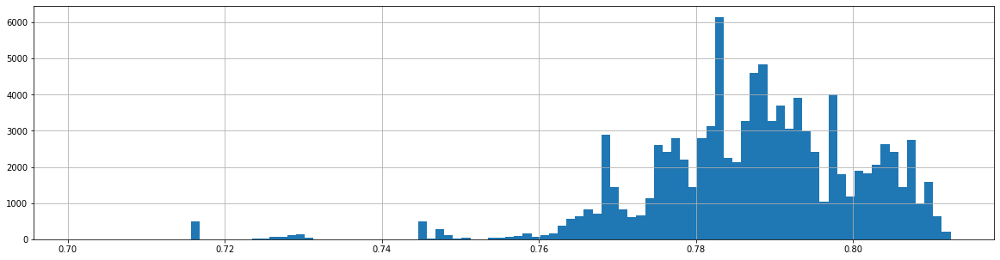

In [30]:
best.min_whole_validation_auc.hist(bins=100);

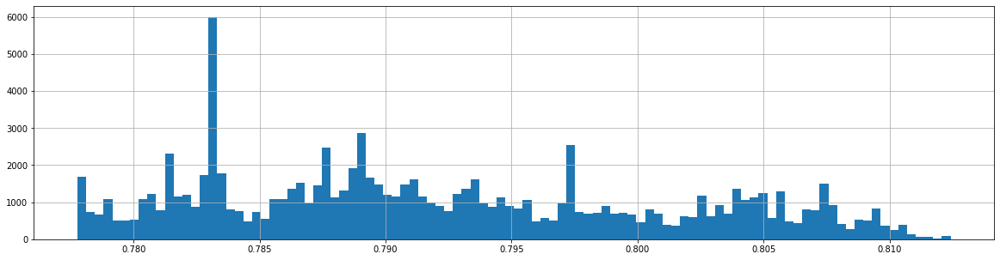

In [31]:
true_best.min_whole_validation_auc.hist(bins=100);

In [32]:
best_iteration = best.sort_values('mean_dev_auc').groupby(['file', 'experiment_id']).last()

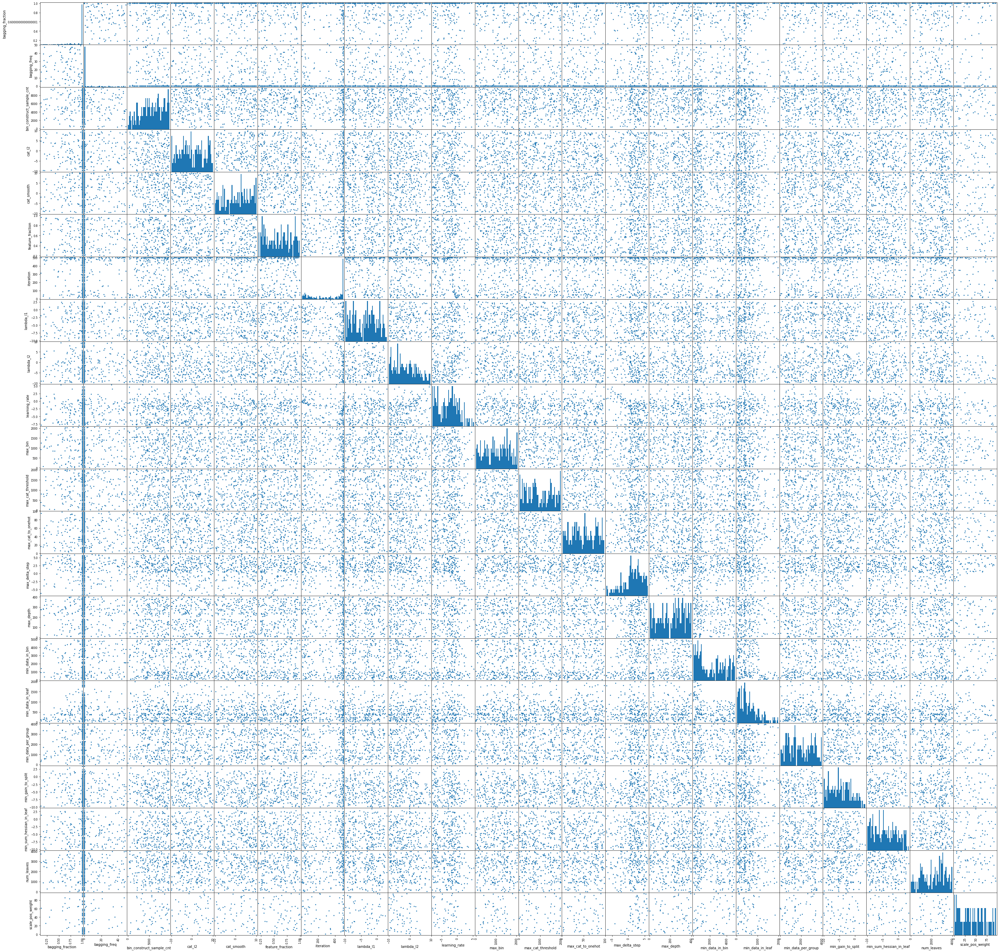

In [46]:
pd.plotting.scatter_matrix(
    pd.concat([best_iteration[CONT_PARAMETERS + INT_PARAMETERS], 
               np.log10(best_iteration[list(set(LOG_PARAMETERS))])],
              axis='columns',
              sort=True
             ).rename(lambda x: x.replace('param_', ''), axis='columns').sort_index(axis=1),
    alpha=1, figsize=(50, 50), hist_kwds={'bins': 50});

### check failures in best selected parameter range

In [34]:
best_range = best\
    [[c for c in best.columns if c.startswith('param_') and not c in SET_PARAMETERS]]\
    .drop(columns=['param_seed', 'param_bagging_enable'])\
    .quantile([0, 1]).T
best_range

,0.0,1.0
param_bagging_fraction,1.229164e-01,1.000000e+00
param_bagging_freq,0.000000e+00,4.900000e+01
param_bin_construct_sample_cnt,1.000000e+01,9.706000e+03
param_cat_l2,1.012291e-10,9.845643e+09
param_cat_smooth,1.040472e-10,9.847039e+09
param_feature_fraction,2.008578e-01,9.977182e-01
param_lambda_l1,1.061871e-10,1.215634e+03
param_lambda_l2,1.152914e-10,3.467728e+09
param_learning_rate,1.126985e-08,2.009177e+05
param_max_bin,4.000000e+00,2.043000e+03


In [35]:
dfs = []
for f in files:
    df = pd.read_pickle(f).assign(file=f)
    for (n, l, h) in best_range.itertuples():
        df = df[(((df[n] >= l) & (df[n] <= h))
                 | df[n].isna())].copy()
    dfs.append(df)

limited = pd.concat(dfs, ignore_index=True, sort=True)
del dfs
limited.shape

(1039500, 61)

In [36]:
limited_best_iteration = limited.sort_values('min_whole_validation_auc').groupby(['file', 'experiment_id']).last()
limited_best_iteration.shape

(2079, 59)

In [37]:
limited_best_iteration['param_bagging_enable'] = (limited_best_iteration.param_bagging_freq != 0)

In [38]:
limited_best_iteration.min_whole_validation_auc.describe()

count    2079.000000
mean        0.599971
std         0.118224
min         0.493961
25%         0.500000
50%         0.500000
75%         0.724627
max         0.812425
Name: min_whole_validation_auc, dtype: float64

In [39]:
limited_bad = limited_best_iteration[limited_best_iteration.min_whole_validation_auc < 0.6]

In [40]:
limited_bad.shape

(1177, 60)

TODO pikachu with bruises reaction

In [41]:
limited_bad.groupby(SET_PARAMETERS).size()

param_is_unbalance  param_boost_from_average
False               False                       332
                    True                        358
True                False                       205
                    True                        282
dtype: int64

In [42]:
limited_bad.groupby('param_bagging_enable').size()

param_bagging_enable
False    502
True     675
dtype: int64

In [43]:
limited_best_iteration.groupby(SET_PARAMETERS).min_whole_validation_auc.describe()

count      mean       std  \
param_is_unbalance param_boost_from_average                              
False              False                     492.0  0.571287  0.105800   
                   True                      470.0  0.556249  0.103186   
True               False                     561.0  0.653505  0.121484   
                   True                      556.0  0.608296  0.115002   

                                                  min  25%       50%  \
param_is_unbalance param_boost_from_average                            
False              False                     0.500000  0.5  0.500000   
                   True                      0.500000  0.5  0.500000   
True               False                     0.500000  0.5  0.702412   
                   True                      0.493961  0.5  0.589059   

                                                  75%       max  
param_is_unbalance param_boost_from_average                      
False              False                     0.649982  0.812425  
                   True                      0.508663  0.812332  
True               False                     0.764439  0.809181  
                   True                      0.719428  0.811704

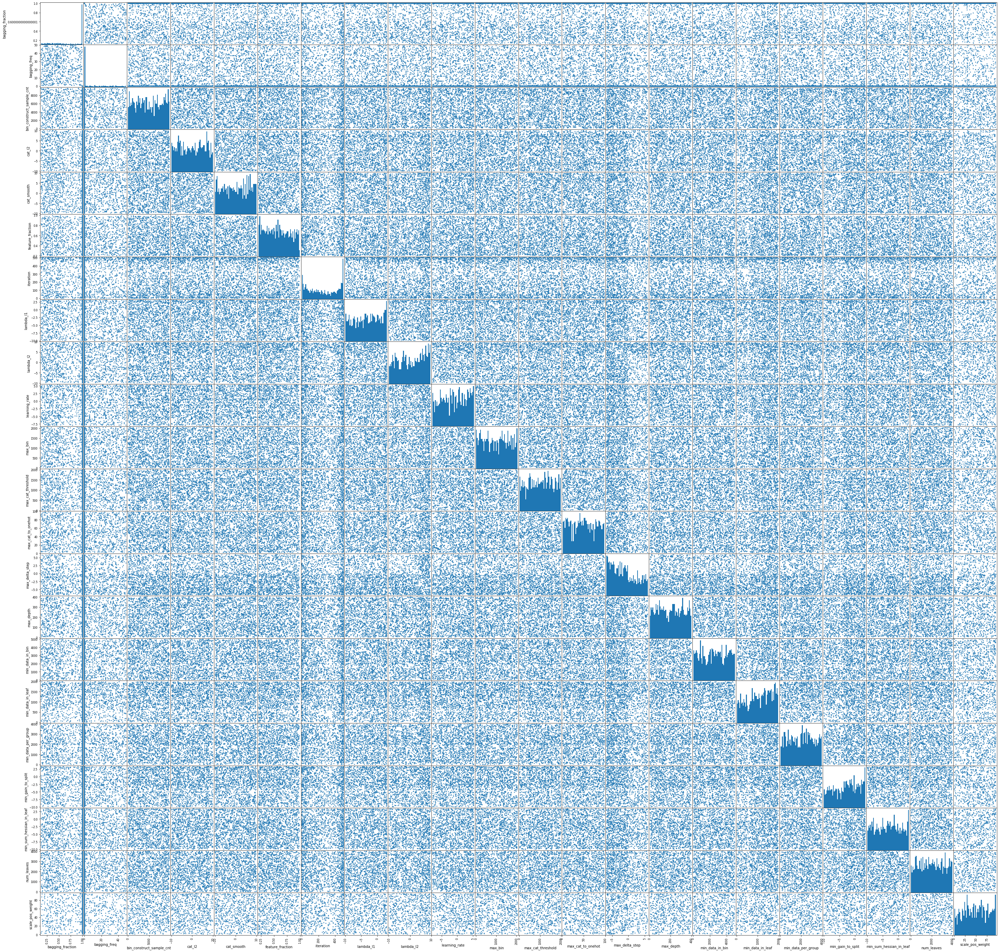

In [47]:
pd.plotting.scatter_matrix(
    pd.concat([limited_bad[CONT_PARAMETERS + INT_PARAMETERS], 
               np.log10(limited_bad[list(set(LOG_PARAMETERS))])],
              axis='columns',
              sort=True
             ).rename(lambda x: x.replace('param_', ''), axis='columns').sort_index(axis=1),
    alpha=0.8, figsize=(50, 50), hist_kwds={'bins': 50});

### top parameters

In [45]:
with pd.option_context('display.max_rows', None, 'display.max_columns', None):
    print(best_iteration.sort_values('mean_dev_auc', ascending=False).head().T)

file                                 ./experiments/wide-20shuffle-3seed.pkl  \
experiment_id                                                          273    
cnt                                                                       3   
iteration                                                                68   
max_dev_auc                                                        0.856704   
max_dev_binary_logloss                                               1.6425   
max_overfit_auc                                                   0.0345223   
max_overfit_binary_logloss                                        0.0442678   
max_validation_auc                                                 0.811469   
max_validation_binary_logloss                                       1.65379   
max_whole_train_auc                                                0.841907   
max_whole_train_binary_logloss                                       1.5662   
max_whole_validation_auc                            